# Stopping Customers from Leaving
John is a little worrried that his team isn't doing his best to retain customers. Rather than just randomly deploying loyalty programs and techniques, he approaches you to see if there's a better way to predict which customers aren't happy. 

# 1. Import Data

In [2]:
!pip install pandas pandas-profiling ipywidgets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 3.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.3/138.3 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 27.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.0/215.0 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 652.9/652.9 kB 15.9 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.1/133.1 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 38.8 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.4/189.4 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.5/160.5 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.1/35.1 MB 27.8 MB/s eta 0:00:00

In [3]:
!pip show pandas-profiling

Name: pandas-profiling
Version: 3.6.6
Summary: Deprecated 'pandas-profiling' package, use 'ydata-profiling' instead
Home-page: https://github.com/ydataai/pandas-profiling
Author: YData Labs Inc
Author-email: opensource@ydata.ai
License: MIT
Location: /Users/belen/Desktop/Full Stack Machine Learning/fullstack/lib/python3.10/site-packages
Requires: ydata-profiling
Required-by: 


In [10]:
import pandas as pd
import numpy as np

In [2]:
df = pd.read_csv('classificationdata.csv', index_col = 'id')

In [8]:
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


# 2. Split Data to Prevent Snooping Bias

In [3]:
from sklearn.model_selection import train_test_split

In [4]:
train, test = train_test_split(df, test_size=0.3, random_state=1234)

In [12]:
print(train.shape)
print(test.shape)

(12070, 24)
(5173, 24)


In [ ]:
# alternative path towards splitting train / test

#X_temp = train.drop('churn', axis=1)
#y_temp = train['churn']

#X_train, X_test, y_train, y_test = train_test_split(X_temp, y_temp, test_size=0.30, random_state=1234, stratify= y_temp)`

# 3. Exploratory Data Analysis

## Birds Eye View

In [5]:
from matplotlib import pyplot as plt

In [14]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12070 entries, 16692 to 1318
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     12070 non-null  object 
 1   tenure                         12070 non-null  int64  
 2   contract_length                12041 non-null  float64
 3   promotions_offered             12041 non-null  object 
 4   remaining_term                 12041 non-null  float64
 5   last_nps_rating                12041 non-null  float64
 6   area_code                      12063 non-null  object 
 7   international_plan             12070 non-null  object 
 8   voice_mail_plan                12050 non-null  object 
 9   number_vmail_messages          12070 non-null  int64  
 10  total_day_minutes              12070 non-null  float64
 11  total_day_calls                12070 non-null  int64  
 12  total_day_charge               12070 non-null  f

In [6]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered               29
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [16]:
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,12070.000000,12041.000000,12041.000000,12041.000000,12070.000000,12070.000000,12070.000000,12070.000000,12058.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000
mean,100.310771,15.924840,11.137115,6.102815,8.638608,179.821368,100.064374,30.574659,200.288303,100.416984,17.014347,199.546252,99.791881,8.979010,10.300118,4.961806,2.774743,1.555344
std,39.742023,4.904918,7.212212,2.723722,13.030305,54.694309,20.137844,9.301168,50.899001,19.898596,4.319807,50.871813,20.195931,2.285268,2.804826,2.508605,0.750105,1.317849
min,1.000000,8.000000,1.000000,1.000000,0.000000,1.383902,1.000000,0.119603,7.605489,1.000000,1.052621,4.247707,1.000000,0.472320,0.032252,0.000000,0.013478,0.000000
25%,73.000000,12.000000,5.000000,4.000000,1.000000,142.621175,87.000000,24.323777,166.719227,87.000000,14.152096,165.683627,86.000000,7.446210,8.529475,3.000000,2.299756,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,179.705079,100.000000,30.517433,200.746807,101.000000,17.049083,198.635687,99.000000,8.952996,10.382980,5.000000,2.812103,1.000000
75%,127.000000,20.000000,17.000000,8.000000,16.000000,217.024361,113.000000,36.834662,233.943152,114.000000,19.870764,234.236992,114.000000,10.520554,12.066125,6.000000,3.256842,2.000000
max,238.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.474658,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


In [17]:
train.describe(include='object')

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,12070,12041,12063,12070,12050,12041
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,398,10957,6049,10957,8887,10314


In [ ]:
# Magic commands: https://ipython.readthedocs.io/en/stable/interactive/magics.html

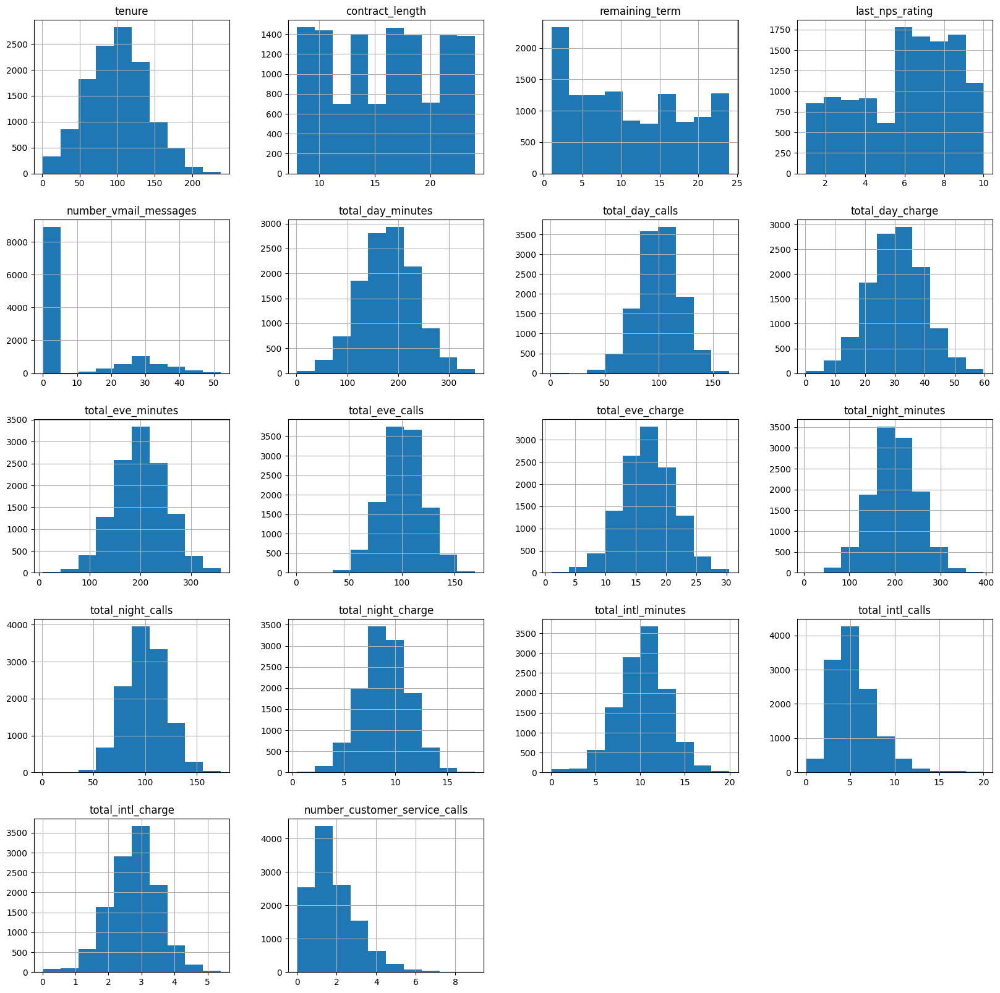

In [21]:
%matplotlib inline 
train.hist(figsize=(20,20))
plt.show()

## Faster EDA with Pandas Profiling

In [7]:
# Import pandas profiling
from pandas_profiling import ProfileReport

/var/folders/wb/ftntp08s0md7rdp8vcbnzxzm0000gn/T/ipykernel_1297/131833715.py:2: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [23]:
# Create new profile report
profile = ProfileReport(train, title= 'Pandas Profiling Report')

In [25]:
profile

## Analyse Categorical FeaturesProfileReport

### Inspect Target Features

In [8]:
#Import data viz capabilities
from matplotlib import pyplot as plt
import seaborn as sns

In [27]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,139,18.927987,217.002619,70,9.332900,8.308312,9,2.208759,2,no
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,124,16.126664,224.264014,89,10.263007,8.238645,2,2.168779,1,yes
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,109,20.911572,123.234534,87,5.731597,11.084169,5,3.153671,0,no
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,91,17.844030,215.835004,91,9.407576,19.981388,4,5.242569,0,no
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,103,12.536175,246.694873,130,10.800377,11.670808,9,3.205746,2,no


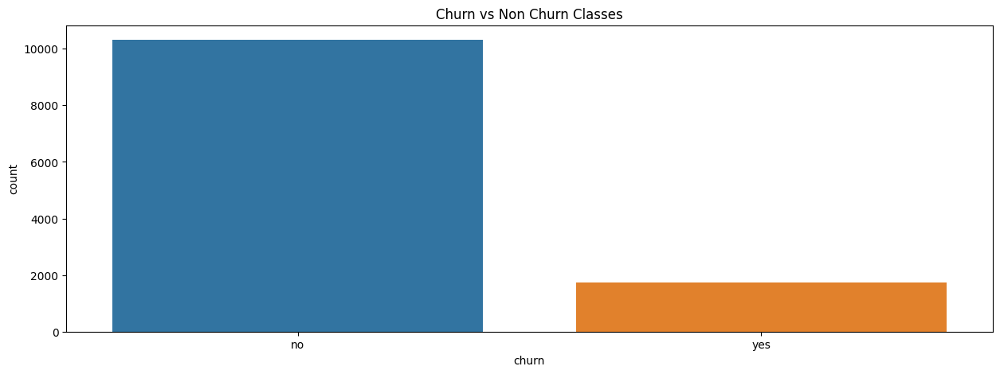

In [28]:
plt.figure(figsize=(15,5))
sns.countplot(x='churn', data=train).set_title('Churn vs Non Churn Classes')
plt.show()

### Inspect State, Area Code and Promotions Offered

In [29]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

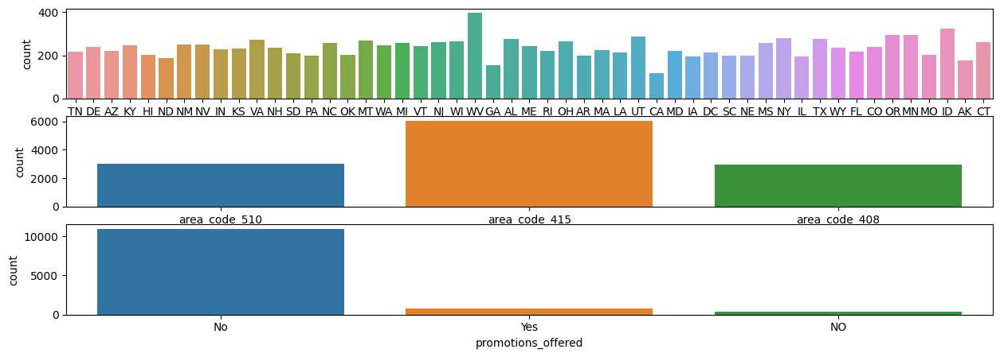

In [32]:
# Plotting out multiple plots in the same canvas
fig, axs = plt.subplots(3, figsize=(15,5))
sns.countplot(data=train, x='state_code', ax=axs[0])
sns.countplot(data=train, x='area_code', ax=axs[1])
sns.countplot(data=train, x='promotions_offered', ax=axs[2])
plt.show()

In [33]:
# Save plot to disc
fig.get_figure().savefig('outputplot.png')

## Analyse Numeric Features

### Inspect Vmail messages and Customer Service Calls

Text(0.5, 1.0, 'Customer Service')

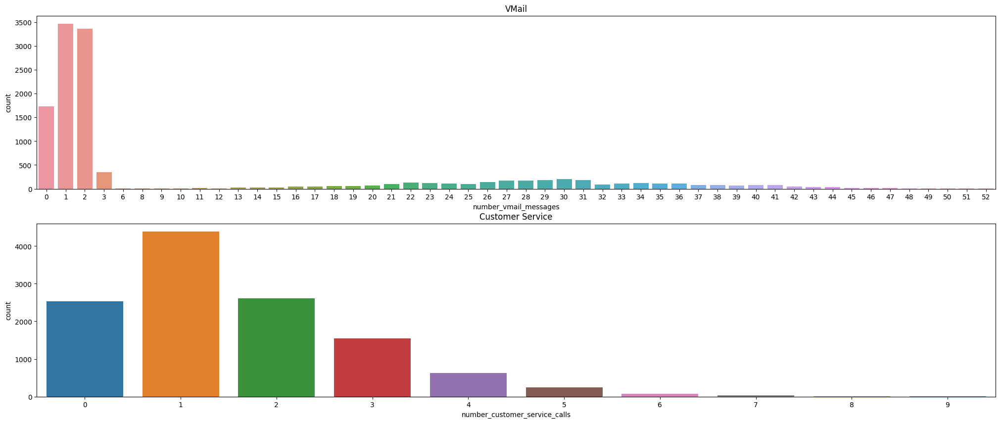

In [38]:
#viz for Vmail and customer service
fig, axs = plt.subplots(2, figsize=(25,10))
sns.countplot(x='number_vmail_messages', data=train, ax=axs[0]).set_title('VMail')
sns.countplot(x='number_customer_service_calls', data=train, ax=axs[1]).set_title('Customer Service')

### Analyse Customer Service Calls given it's Skewed

In [39]:
import numpy as np

In [40]:
train['number_customer_service_calls'].skew()

1.086776733503893

In [41]:
train['log_customer_service_calls'] = np.log(train['number_customer_service_calls']+1) 

In [42]:
train.log_customer_service_calls.skew()

-0.11828354478767099

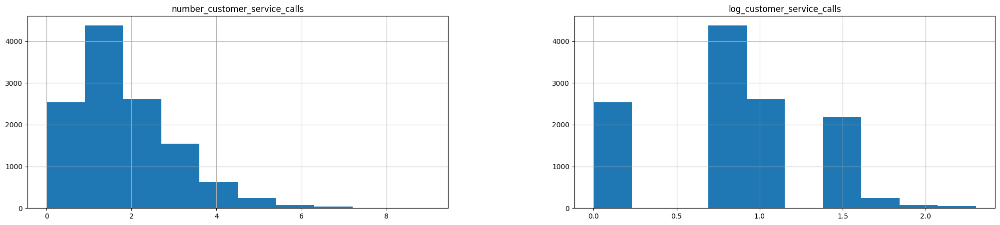

In [43]:
train[['number_customer_service_calls', 'log_customer_service_calls']].hist(figsize=(25, 5))
plt.show()

In [44]:
train = train.drop('log_customer_service_calls', axis=1)
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

## Analyse Relationships

### Look into Numeric/Numeric Correlation

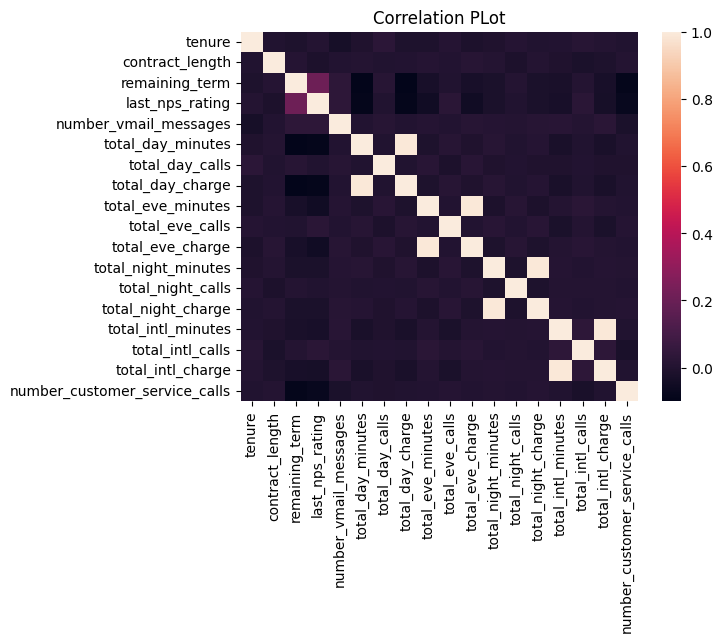

In [52]:
# viz correlation plot
sns.heatmap(train.select_dtypes(exclude='object').corr()).set_title('Correlation PLot')
plt.show()

In [53]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

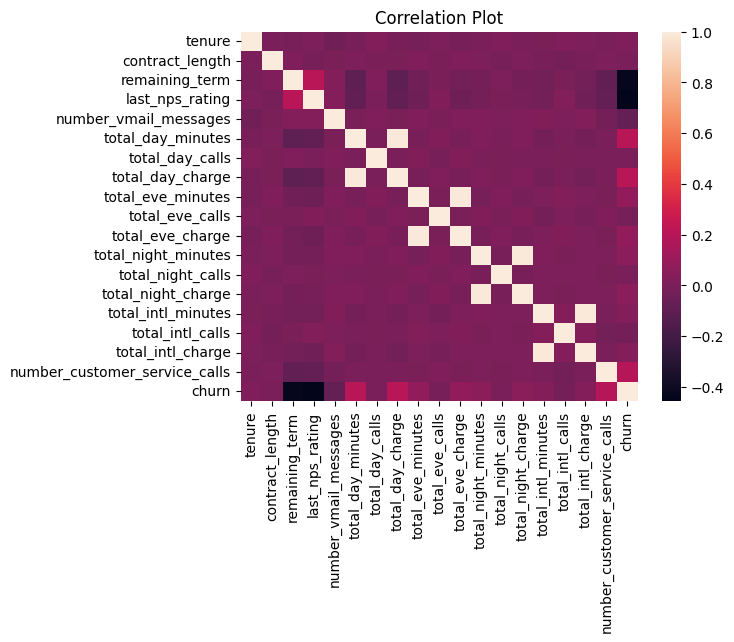

In [56]:
temp = train.copy()
temp['churn'] = temp['churn'].apply(lambda x:1 if x=='yes' else 0)
sns.heatmap(temp.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

### Plot Churn Distributions

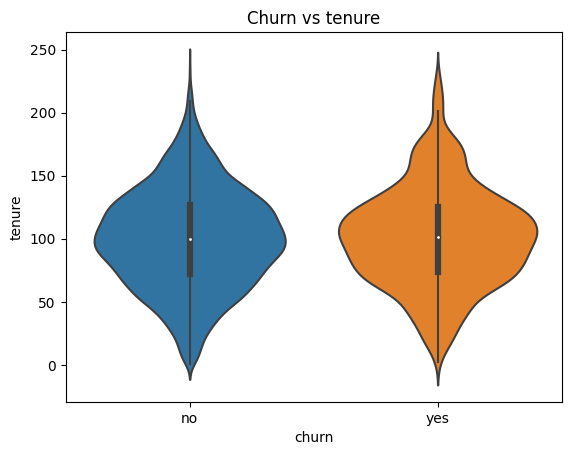

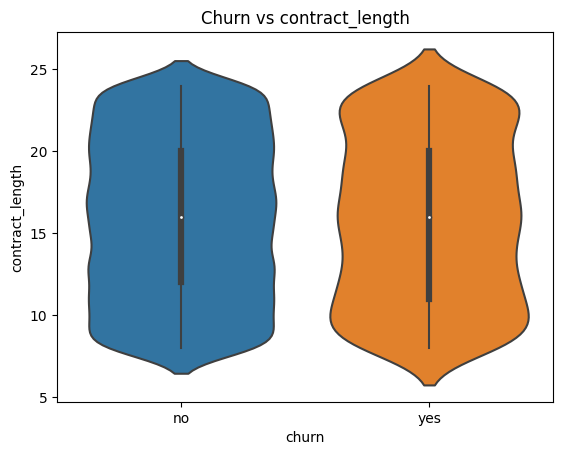

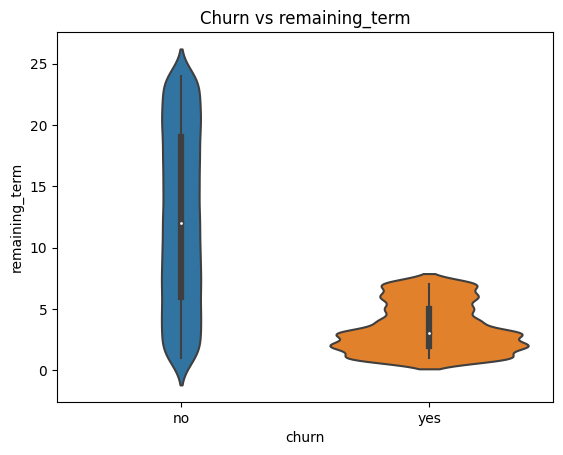

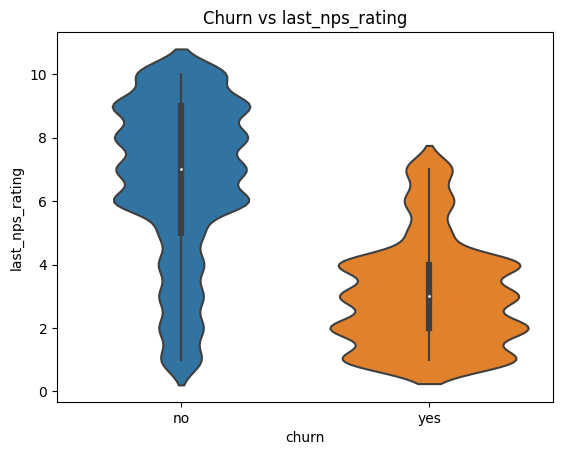

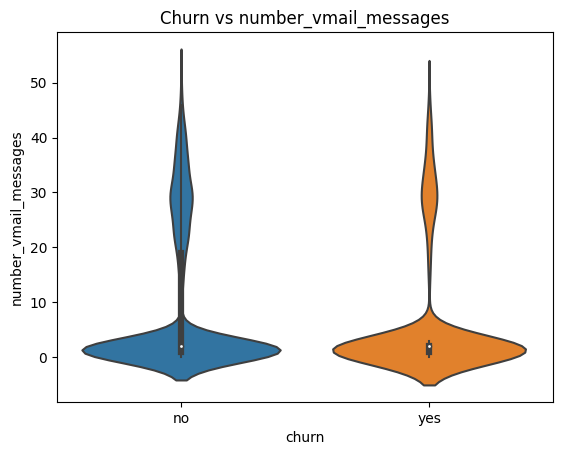

...

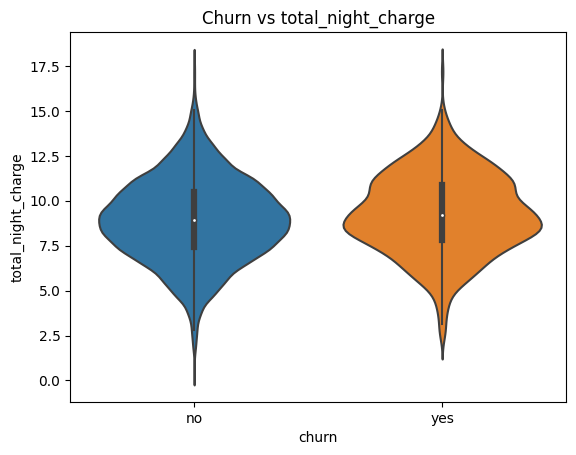

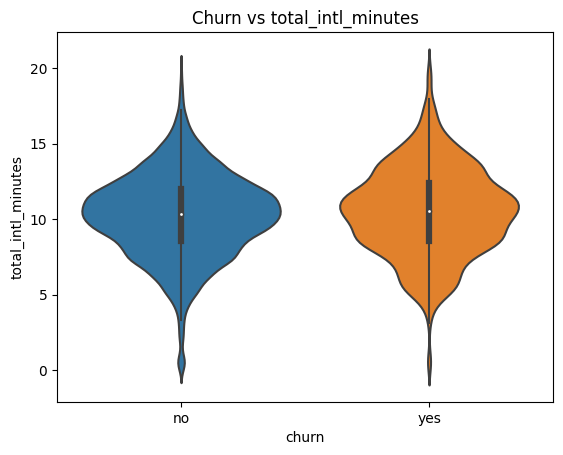

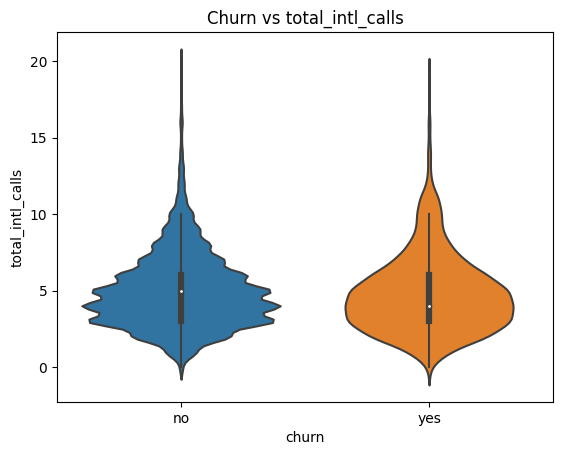

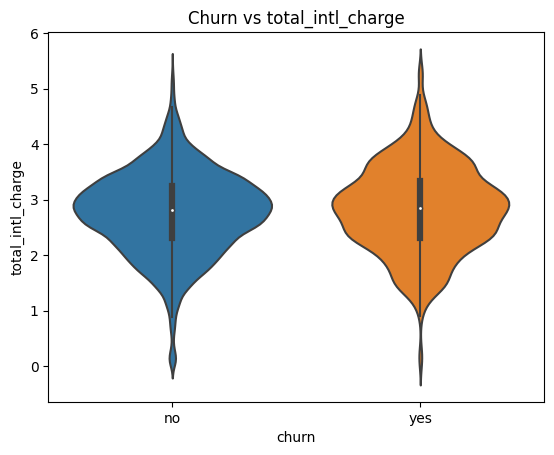

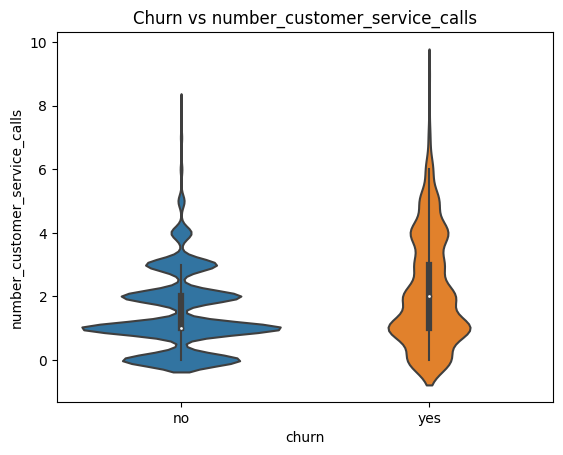

In [57]:
# viz violin plots for numerical features vs target churn
for col in train.select_dtypes(exclude='object').columns:
    sns.violinplot(x='churn', y=col, data=train).set_title(f'Churn vs {col}')
    plt.show()

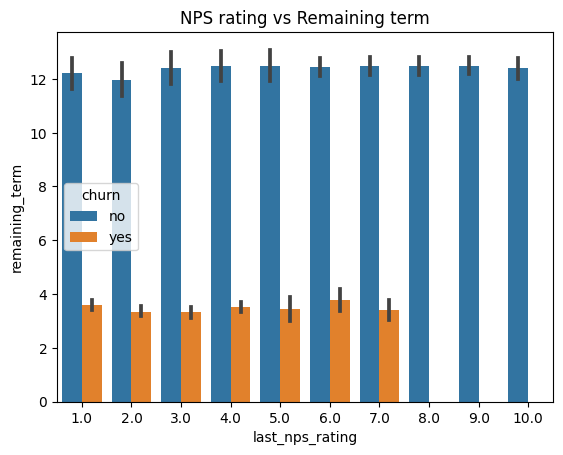

In [58]:
plt.title('NPS rating vs Remaining term')
sns.barplot(x= 'last_nps_rating', y='remaining_term', hue='churn', data=train)
plt.show()

### What about Categorical Relationships to Churn

In [59]:
#display unique values
train.promotions_offered.unique()

array(['No', 'Yes', 'NO', nan], dtype=object)

In [11]:
#replace incorrect inputed values - NO and nan values with No
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [62]:
train.promotions_offered.unique()

array(['No', 'Yes'], dtype=object)

In [64]:
# create pivot table / crosstab
pivot_feature = 'promotions_offered'
pd.crosstab(train[pivot_feature], train['churn']) / len(train)

churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


In [67]:
# Loop through and create a crosstab for all categorical features
for col in train.select_dtypes(include='object').columns:
    if col != 'churn':
        display(pd.crosstab(train[col], train['churn']) / len(train))

churn,no,yes
state_code,,
AK,0.013670,0.000829
AL,0.019553,0.002900
AR,0.014167,0.002403
AZ,0.016321,0.001657
CA,0.007539,0.002237
CO,0.017647,0.002237
CT,0.018558,0.003231
DC,0.014250,0.003065
DE,0.016239,0.003480


churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


churn,no,yes
area_code,,
area_code_408,0.210025,0.036205
area_code_415,0.430655,0.069097
area_code_510,0.213256,0.037780


churn,no,yes
international_plan,,
no,0.796935,0.108451
yes,0.057581,0.034631


churn,no,yes
voice_mail_plan,,
no,0.616321,0.118973
yes,0.237117,0.023529


### Is there a relationship between Remaining term and NPS Rating? And...promotions offered?
Namely when Remaining term < 5 and Last nps rating < 7

In [93]:
train[['remaining_term']].head()

,remaining_term
id,
16692,23.0
6970,7.0
9747,18.0
16099,12.0
8833,23.0


In [12]:
train['nps_less_7'] = (train['last_nps_rating'] <= 7).astype(int)
train['remaining_term_less_5'] = (train['remaining_term'] < 5).astype(int)
train['churn_yes'] = train['churn'].apply(lambda x: 1 if x=='yes' else 0)
train['churn_no'] = train['churn'].apply(lambda x: 0 if x=='yes' else 1)

In [95]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,nps_less_7,remaining_term_less_5,churn_yes,churn_no
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,9.332900,8.308312,9,2.208759,2,no,0,0,0,1
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,10.263007,8.238645,2,2.168779,1,yes,1,0,1,0
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,5.731597,11.084169,5,3.153671,0,no,0,0,0,1
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,9.407576,19.981388,4,5.242569,0,no,1,0,0,1
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,10.800377,11.670808,9,3.205746,2,no,1,0,0,1


In [13]:
train.groupby(['nps_less_7', 'remaining_term_less_5']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.000000  0.305220
           1                       0.000000  0.061392
1          0                       0.043331  0.405468
           1                       0.099751  0.084838

In [14]:
train.groupby(['nps_less_7', 'remaining_term_less_5', 'promotions_offered']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.000000  0.305220
           1                     No                   0.000000  0.061392
1          0                     No                   0.035543  0.405468
                                 Yes                  0.007788  0.000000
           1                     No                   0.080116  0.052361
                                 Yes                  0.019635  0.032477

In [15]:
train.drop(['nps_less_7', 'remaining_term_less_5','churn_yes', 'churn_no'], axis=1, inplace=True)

In [16]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

# 4. Data Preprocessing

## Double check we're operating with a clean slate

In [101]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [102]:
df.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [17]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

## Missing Area Code Data - Categorical

In [18]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [19]:
train[train['area_code'].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no


In [20]:
train['area_code'] = train['area_code'].fillna('missing')
train[train['area_code']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,missing,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,missing,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
16450,FL,147,16.0,No,9.0,8.0,missing,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
12972,MO,153,24.0,No,13.0,6.0,missing,yes,no,0,...,98,8.515226,207.015705,92,9.090795,7.466579,6,2.008288,0,no


## Missing Voice Mail Plan - Categorical

In [24]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [25]:
train['voice_mail_plan'] = train['voice_mail_plan'].fillna('missing')
train[train['voice_mail_plan']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16429,HI,44,21.0,No,20.0,10.0,area_code_510,no,missing,1,...,102,18.016167,187.208784,90,8.690546,11.481874,2,3.017702,1,no
10372,HI,42,8.0,No,7.0,6.0,area_code_510,no,missing,2,...,106,17.749234,185.584080,92,8.224325,11.041335,2,3.105547,1,no
11974,MO,15,14.0,No,17.0,9.0,area_code_510,no,missing,1,...,69,11.871465,145.341081,102,7.051341,8.259750,9,2.296696,1,no
3365,MO,18,22.0,No,12.0,2.0,area_code_415,no,missing,2,...,77,22.896967,178.095650,103,8.785522,6.028258,6,1.874301,0,no
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
7767,AZ,4,9.0,No,7.0,3.0,area_code_408,no,missing,0,...,119,21.481234,281.874501,91,12.695069,11.408316,4,3.225750,1,yes
16037,AZ,6,16.0,No,3.0,2.0,area_code_408,no,missing,2,...,122,22.108010,288.967333,88,13.270796,11.430051,3,3.059472,1,yes
4558,WY,58,22.0,No,20.0,6.0,missing,no,missing,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
8645,MT,60,17.0,Yes,1.0,4.0,area_code_415,no,missing,1,...,75,19.991544,180.150988,108,8.345667,9.549767,3,2.468519,1,yes


## Missing Evening Minutes - Numeric

In [28]:
train[train['total_eve_minutes'].isnull()][['total_eve_minutes', 'churn']]

,total_eve_minutes,churn
id,,
16142,NaN,no
17168,NaN,no
4558,NaN,no
11193,NaN,yes
15828,NaN,no
12703,NaN,yes
2729,NaN,no
11475,NaN,no
15905,NaN,no


In [29]:
mean_eve_mins = train['total_eve_minutes'].mean().round(2)
mean_eve_mins

200.29

In [ ]:
train['total_eve_minutes']

In [30]:
train['total_eve_minutes_missing'] = train['total_eve_minutes'].isnull().astype(int)
train['total_eve_minutes'] = train['total_eve_minutes'].fillna(mean_eve_mins)

In [33]:
train[train['total_eve_minutes_missing']==1][['total_eve_minutes_missing', 'total_eve_minutes']]

,total_eve_minutes_missing,total_eve_minutes
id,,
16142,1,200.29
17168,1,200.29
4558,1,200.29
11193,1,200.29
15828,1,200.29
12703,1,200.29
2729,1,200.29
11475,1,200.29
15905,1,200.29


## Missing Target Variables

In [34]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [38]:
train[train['churn'].isnull()]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,
16332,MD,122,NaN,No,NaN,NaN,area_code_415,no,yes,23,...,14.793215,182.636917,88,8.010870,10.056127,4,2.939355,0,NaN,0
7783,MD,120,NaN,No,NaN,NaN,area_code_415,no,yes,21,...,19.158348,196.490215,88,8.102877,6.664837,7,1.809716,0,NaN,0
5127,OK,112,NaN,No,NaN,NaN,area_code_408,no,yes,22,...,13.792718,123.245273,90,6.014336,9.973846,4,2.475189,1,NaN,0
14246,DC,153,NaN,No,NaN,NaN,area_code_415,no,yes,39,...,20.009556,108.850795,112,4.465479,16.262170,4,4.354153,2,NaN,0
1612,DE,122,NaN,No,NaN,NaN,area_code_510,no,no,3,...,23.760171,185.767515,108,8.484626,12.406104,4,3.337480,1,NaN,0
2332,MD,113,NaN,No,NaN,NaN,area_code_415,no,yes,22,...,14.263494,187.836743,117,8.010496,10.394618,6,2.959332,0,NaN,0
3544,MT,94,NaN,No,NaN,NaN,area_code_415,no,no,2,...,17.301119,151.211658,125,6.476868,13.838875,3,3.773066,0,NaN,0
5704,MI,151,NaN,No,NaN,NaN,area_code_415,no,yes,27,...,15.552741,100.479370,134,5.066794,6.697073,5,1.689119,3,NaN,0
12038,MT,91,NaN,No,NaN,NaN,area_code_415,no,no,2,...,17.876354,150.315865,128,6.388716,13.326148,3,3.637971,0,NaN,0


In [42]:
#train[~train['churn'].isnull()].isnull().sum() #check if it properly gets rid of rows with null values on target
train = train[~train['churn'].isnull()] # to get rid of the rows with null values on the target
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

In [43]:
train[train['churn'].isnull()]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,


# 5. Feature Engineering

## Ratio for Correlated Predictor Variables

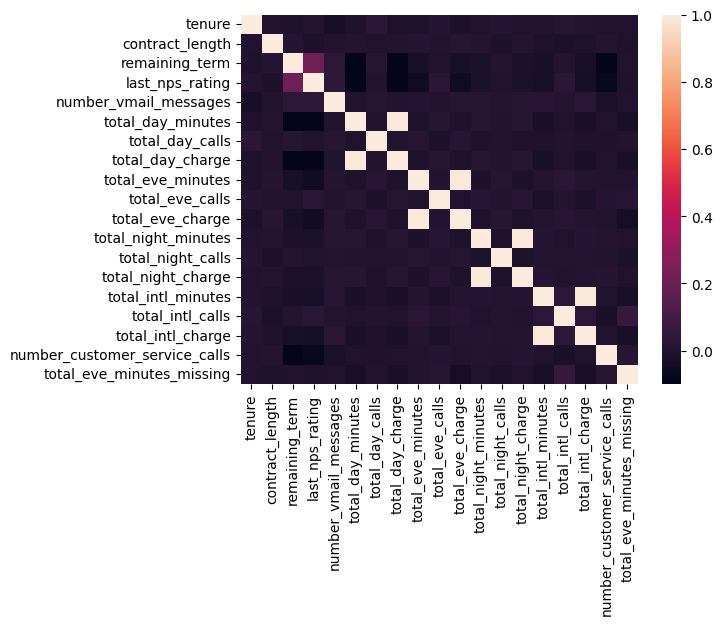

In [46]:
sns.heatmap(train.select_dtypes(exclude='object').corr())
plt.show()

In [48]:
# Create ratios
train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
train['night_ratio'] = train['total_night_charge'] / train['total_night_minutes']
train['intl_ratio'] = train['total_intl_charge'] / train['total_intl_minutes']

/var/folders/wb/ftntp08s0md7rdp8vcbnzxzm0000gn/T/ipykernel_1297/1293876516.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
/var/folders/wb/ftntp08s0md7rdp8vcbnzxzm0000gn/T/ipykernel_1297/1293876516.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
/var/folders/wb/ftntp08s0md7rdp8vcbnzxzm0000gn/T/ipykernel_1297/1293876516.py:4: SettingWithCopyWarning: 


In [49]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,8.308312,9,2.208759,2,no,0,0.172815,0.083632,0.043008,0.265849
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,8.238645,2,2.168779,1,yes,0,0.169215,0.084485,0.045763,0.263245
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,11.084169,5,3.153671,0,no,0,0.158396,0.088938,0.046510,0.284520
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,19.981388,4,5.242569,0,no,0,0.178475,0.086951,0.043587,0.262373
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,11.670808,9,3.205746,2,no,0,0.168656,0.081817,0.043780,0.274681


In [50]:
train = train.drop(['total_day_charge', 'total_day_minutes', 'total_eve_charge', 'total_eve_minutes','total_night_charge', 
            'total_night_minutes', 'total_intl_charge', 'total_intl_minutes' ], axis=1)

In [51]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'churn', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio'],
      dtype='object')

## Skewed Customer Service Calls

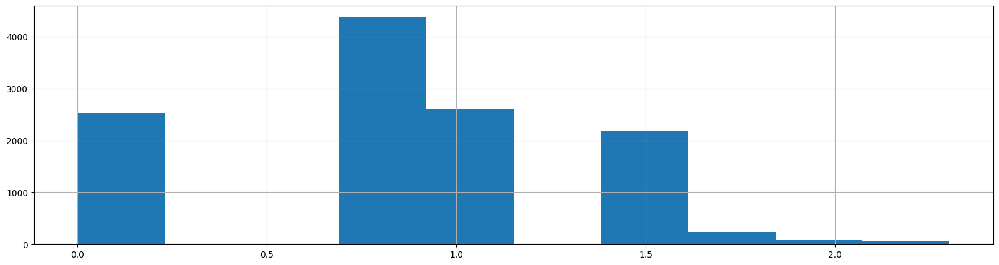

In [52]:
train['number_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)
train['number_customer_service_calls'].hist(figsize=(20,5))
plt.show()

## Feature Engineering Unhappy Customers

In [53]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [54]:
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_calls                  0
total_eve_calls                  0
total_night_calls                0
total_intl_calls                 0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
day_ratio                        0
eve_ratio                        0
night_ratio                      0
intl_ratio                       0
dtype: int64

In [55]:
# create new feature for flagging unhappy customers
train['unhappy_customers'] = ((train.remaining_term < 5) & (train.last_nps_rating <= 7) & (train.promotions_offered == 'No')).astype(int)

In [57]:
# Filter by conditions to confirm transformation
train[train['remaining_term'] <5][['remaining_term', 'last_nps_rating', 'promotions_offered', 'unhappy_customers']]

,remaining_term,last_nps_rating,promotions_offered,unhappy_customers
id,,,,
3584,3.0,3.0,No,1
2164,1.0,6.0,Yes,0
16624,3.0,8.0,No,0
17212,4.0,2.0,No,1
2321,2.0,7.0,No,1
...,...,...,...,...
3153,1.0,2.0,No,1
16387,3.0,4.0,No,1
7644,3.0,6.0,No,1


In [58]:
train.head(3)

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_calls,total_intl_calls,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio,unhappy_customers
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,70,9,1.098612,no,0,0.172815,0.083632,0.043008,0.265849,0
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,89,2,0.693147,yes,0,0.169215,0.084485,0.045763,0.263245,0
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,87,5,0.000000,no,0,0.158396,0.088938,0.046510,0.284520,0


## Create Target and Feature Variables

In [60]:
from sklearn.preprocessing import OneHotEncoder

In [61]:
# Create X and Y variables
X_train = train.drop('churn', axis=1)
y_train = np.where(train['churn']=='yes', 1, 0)

In [65]:
#validating churn is dropped
'churn' in list(X_train.columns)

False

In [64]:
# check y value
y_train

array([0, 1, 0, ..., 0, 0, 0])

In [67]:
# Create the one hot encoder
onehot = OneHotEncoder(handle_unknown='ignore')
# Apply one hot encoding to categorical columns
encoded_columns = onehot.fit_transform(X_train.select_dtypes(include='object')).toarray()

In [68]:
encoded_columns

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

In [69]:
#see all columns created with the one hot encoder
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [70]:
X_train = X_train.select_dtypes(exclude='object')
X_train[onehot.get_feature_names_out()] = encoded_columns

In [71]:
X_train.head()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
16692,100,18.0,23.0,9.0,2,80,139,70,9,1.098612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
6970,92,15.0,7.0,7.0,0,106,124,89,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
9747,62,10.0,18.0,10.0,20,127,109,87,5,0.000000,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
16099,143,12.0,12.0,6.0,1,120,91,91,4,0.000000,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
8833,123,19.0,23.0,7.0,0,105,103,130,9,1.098612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0


In [72]:
X_train.columns

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

## Dealing with Imbalanced Classes

In [73]:
!pip install imblearn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.6/235.6 kB 3.0 MB/s eta 0:00:00a 0:00:01

[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: pip install --upgrade pip


In [76]:
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

In [86]:
# Create smote class
sm = SMOTE(random_state=1234)
# Resample to balance the dataset
X_temp, y_temp = sm.fit_resample(X_train, y_train)

In [78]:
print(X_train.shape)
print(y_train.shape)
print(X_temp.shape)
print(y_temp.shape)

(12041, 78)
(12041,)
(20628, 78)
(20628,)


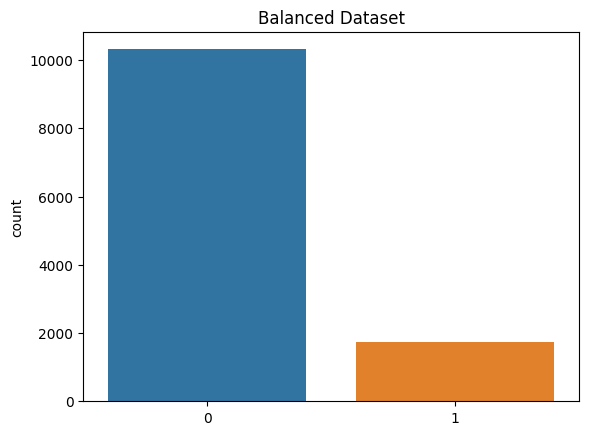

In [81]:
sns.countplot(x=y_train).set_title('Balanced Dataset')
plt.show()

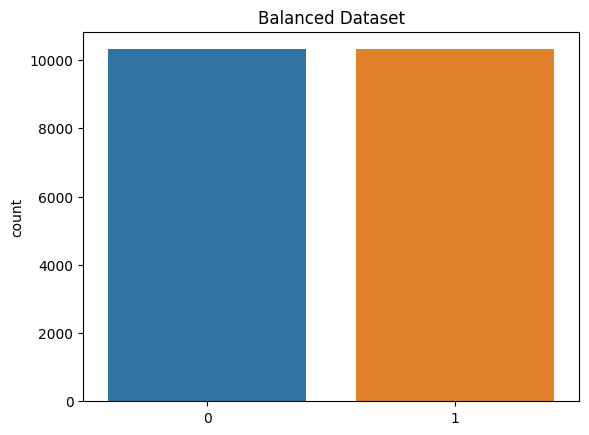

In [85]:
sns.countplot(x=y_temp).set_title('Balanced Dataset')
plt.show()

In [82]:
# Resample to balance the dataset
X_train, y_train = sm.fit_resample(X_train, y_train)

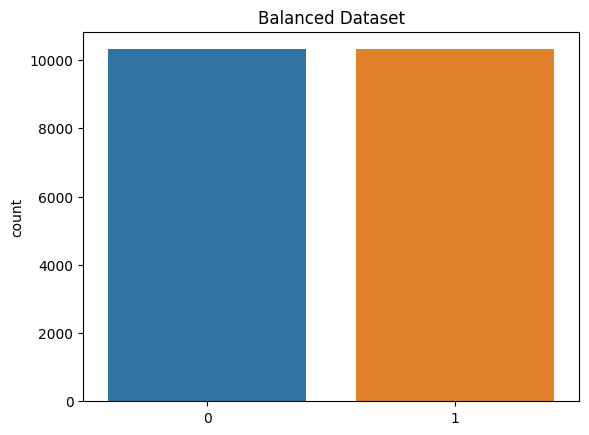

In [83]:
sns.countplot(x=y_train).set_title('Balanced Dataset')
plt.show()

# 6. Modelling

## Build Pipelines

In [90]:
from sklearn.compose import ColumnTransformer

In [88]:
# Import pipeline dependencies
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [89]:
# Import algorithms
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [101]:
pipelines = {
    'sgd':make_pipeline(StandardScaler(), SGDClassifier()), 
    'ridge':make_pipeline(StandardScaler(), RidgeClassifier()), 
    'rf':make_pipeline(StandardScaler(), RandomForestClassifier()), 
    'gb':make_pipeline(StandardScaler(), GradientBoostingClassifier()), 
    'xg':make_pipeline(StandardScaler(), XGBClassifier()), 
}

## Build Grids

In [93]:
pipelines['gb'].get_params()

{'memory': None,
 'steps': [('standardscaler', StandardScaler()),
  ('gradientboostingclassifier', GradientBoostingClassifier())],
 'verbose': False,
 'standardscaler': StandardScaler(),
 'gradientboostingclassifier': GradientBoostingClassifier(),
 'standardscaler__copy': True,
 'standardscaler__with_mean': True,
 'standardscaler__with_std': True,
 'gradientboostingclassifier__ccp_alpha': 0.0,
 'gradientboostingclassifier__criterion': 'friedman_mse',
 'gradientboostingclassifier__init': None,
 'gradientboostingclassifier__learning_rate': 0.1,
 'gradientboostingclassifier__loss': 'log_loss',
 'gradientboostingclassifier__max_depth': 3,
 'gradientboostingclassifier__max_features': None,
 'gradientboostingclassifier__max_leaf_nodes': None,
 'gradientboostingclassifier__min_impurity_decrease': 0.0,
 'gradientboostingclassifier__min_samples_leaf': 1,
 'gradientboostingclassifier__min_samples_split': 2,
 'gradientboostingclassifier__min_weight_fraction_leaf': 0.0,
 'gradientboostingclassifie

In [102]:
grid = {
    'sgd':{
        'sgdclassifier__alpha':[0.00001, 0.0001, 0.001, 0.01]
    },
    'ridge':{
        'ridgeclassifier__alpha':[0.01, 0.5, 1.0, 2.0, 3.0]
    },
    'rf':{
        'randomforestclassifier__n_estimators':[50,100,200,300], 
        'randomforestclassifier__max_depth':[None, 5, 7, 9]
    },
    'gb':{
        'gradientboostingclassifier__n_estimators':[50,100,200,300], 
        'gradientboostingclassifier__max_depth':[None, 3, 5, 7, 9]
    },
    'xg':{
        'xgbclassifier__n_estimators':[50,100,200,300], 
        'xgbclassifier__max_depth':[None, 3, 5, 7, 9]
    }
}

## Train Models

In [97]:
from sklearn.model_selection import GridSearchCV

In [103]:
fit_models = {}
for algo, pipeline in pipelines.items(): 
    try: 
        print(f'Commencing training for {algo}')
        # DO training here 
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10)
        model.fit(X_train, y_train)
        fit_models[algo] = model 
        print(f'Training completed for {algo}')

    except Exception as e: 
        print(f'There was an error training the {algo} model: {e}')

Commencing training for sgd
Training completed for sgd
Commencing training for ridge
Training completed for ridge
Commencing training for rf
Training completed for rf
Commencing training for gb
Training completed for gb
Commencing training for xg
Training completed for xg


In [105]:
fit_models

{'sgd': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('sgdclassifier', SGDClassifier())]),
              n_jobs=-1,
              param_grid={'sgdclassifier__alpha': [1e-05, 0.0001, 0.001, 0.01]}),
 'ridge': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('ridgeclassifier', RidgeClassifier())]),
              n_jobs=-1,
              param_grid={'ridgeclassifier__alpha': [0.01, 0.5, 1.0, 2.0, 3.0]}),
 'rf': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('randomforestclassifier',
                                         RandomForestClassifier())]),
              n_jobs=-1,
              param_grid={'randomforestclassifier__max_depth': [None, 5, 7, 9],
                          'randomforestclassifier__n_estimators':

# 7. Evaluation

## Apply Transformations to Test Data

In [107]:
col_order = X_train.columns; col_order

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

In [108]:
def transform_data(test_df, col_order, mean_eve_mins, onehot):
    
    # Copy dataframe
    X = test_df.copy()
    
    # Data preprocessing - handle missing values
    X['area_code'] = X['area_code'].fillna('missing')
    X['voice_mail_plan'] = X['voice_mail_plan'].fillna('missing')
    X['total_eve_minutes_missing'] = X['total_eve_minutes'].isnull().astype(int)
    X['total_eve_minutes'] = X['total_eve_minutes'].fillna(mean_eve_mins)
    
    # Feature Engineering
    # FE Rations
    X['day_ratio'] = X['total_day_charge'] / X['total_day_minutes']
    X['eve_ratio'] = X['total_eve_charge'] / X['total_eve_minutes']
    X['night_ratio'] = X['total_night_charge'] / X['total_night_minutes']
    X['intl_ratio'] = X['total_intl_charge'] / X['total_intl_minutes']
    X = X.drop(['total_day_charge', 'total_day_minutes', 'total_eve_charge', 'total_eve_minutes','total_night_charge', 'total_night_minutes', 'total_intl_charge', 'total_intl_minutes' ], axis=1)
    
    # FE Log Transform
    X['number_customer_service_calls'] = np.log(X['number_customer_service_calls']+1)
    
    # FE Unhappy Customers
    X['promotions_offered'] = X['promotions_offered'].replace(['NO', np.NaN], 'No')
    X['unhappy_customers'] = ((X.remaining_term < 5) & (X.last_nps_rating <= 7) & (X.promotions_offered == 'No')).astype(int)
    
    # One hot encoding
    encoded_columns = onehot.transform(X.select_dtypes(include='object')).toarray()
    X = X.select_dtypes(exclude='object')
    X[onehot.get_feature_names_out()] = encoded_columns
    
    return X[col_order]

In [109]:
# Filter missing values from test data
test = test[~test['churn'].isnull()]

In [110]:
test.isnull().sum()

state_code                        0
tenure                            0
contract_length                   0
promotions_offered                0
remaining_term                    0
last_nps_rating                   0
area_code                         5
international_plan                0
voice_mail_plan                  10
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 6
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

In [111]:
# Apply data transformation function to X_test
X_test = transform_data(test.drop('churn', axis=1), col_order, mean_eve_mins, onehot)

In [112]:
X_test

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
15297,75,13.0,3.0,9.0,1,121,63,97,6,1.386294,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7075,150,17.0,5.0,9.0,1,111,78,88,4,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3733,87,11.0,6.0,9.0,2,132,95,49,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
10674,110,9.0,19.0,6.0,1,85,116,90,3,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7360,132,23.0,2.0,1.0,0,101,90,93,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,44,24.0,9.0,10.0,2,71,104,113,3,1.386294,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
7101,113,22.0,17.0,9.0,1,112,76,97,6,0.693147,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7062,111,22.0,24.0,9.0,16,78,121,105,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [113]:
# Transform y_test to 1s and 0s
y_test = np.where(test['churn']=='yes', 1, 0)

In [116]:
y_test[:50]

array([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0])

In [115]:
np.sum(y_test)

741

## Evaluate Performance Metrics

In [117]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix

In [119]:
# Loop through the models
for algo, model in fit_models.items():
    # Make predictions
    yhat = model.predict(X_test)
    # Calculating metrics on test partition and predictions
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat)
    # Print results of metrics
    print(f'{algo} model scores Accuracy:{accuracy}, Precision{precision}, Recal{recall}')

sgd model scores Accuracy:0.8919495635305529, Precision0.5773109243697478, Recal0.9271255060728745
ridge model scores Accuracy:0.8622696411251213, Precision0.5111430625449317, Recal0.9595141700404858
rf model scores Accuracy:0.9489815712900097, Precision0.7994987468671679, Recal0.8609986504723347
gb model scores Accuracy:0.9520853540252182, Precision0.8328840970350404, Recal0.8340080971659919
xg model scores Accuracy:0.950921435499515, Precision0.840782122905028, Recal0.8124156545209177


- The precision is the ratio tp / (tp + fp) where tp is the number of true positives and fp the number of false positives. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
- The recall is the ratio tp / (tp + fn) where tp is the number of true positives and fn the number of false negatives. The recall is intuitively the ability of the classifier to find all the positive samples.

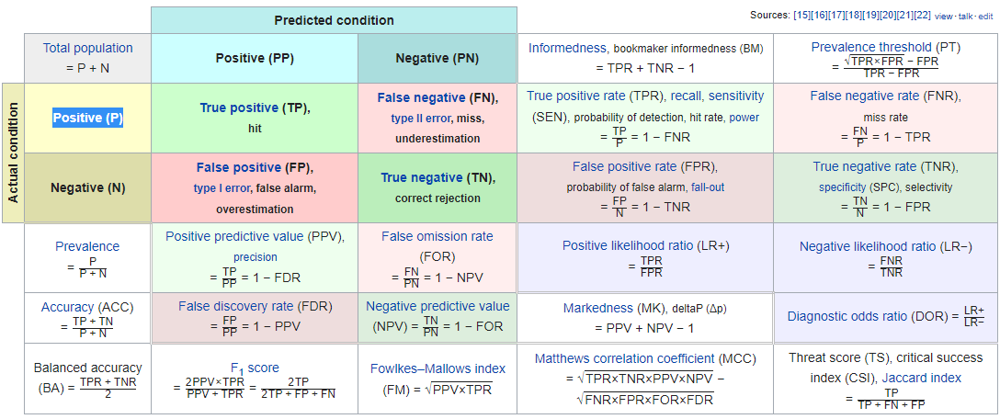

## Understanding Performance Metrics

In [ ]:
# xgmodel scores
#Accuracy:0.950921435499515, Precision0.840782122905028, Recal0.8124156545209177

In [120]:
model = fit_models['xg']

In [121]:
yhat = model.predict(X_test)

In [122]:
yhat[:50]

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0])

In [123]:
confusion_matrix(y_test, yhat, labels=[1,0])

array([[ 602,  139],
       [ 114, 4300]])

In [125]:
accuracy = (602+4300) / (602+4300+139+114) ;accuracy

0.950921435499515

In [128]:
precision = 602 / (602 + 114) ;precision

0.840782122905028

In [127]:
recall = 602 / (602 + 139) ;recall

0.8124156545209177

## Make a Prediction

In [129]:
yhat = model.predict(X_test); yhat

array([0, 0, 0, ..., 0, 0, 0])

In [135]:
# create dataframe
res = pd.DataFrame([y_test, yhat])
# Transpose columns and rows
res = res.T
# Rename column names
res.columns = ['ytrue','ypred']

In [136]:
res.head(10)

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,1,1
5,1,0
6,0,0
7,0,0
8,0,0
9,0,0


In [134]:
X_test.iloc[5]

tenure                     125.0
contract_length             16.0
remaining_term               7.0
last_nps_rating              2.0
number_vmail_messages       36.0
                           ...  
international_plan_no        1.0
international_plan_yes       0.0
voice_mail_plan_missing      0.0
voice_mail_plan_no           0.0
voice_mail_plan_yes          1.0
Name: 13546, Length: 78, dtype: float64

# 8. Deployment

## Save Models and Encoder

In [137]:
import os
import pickle

In [138]:
# Create file paths
SAVE_PATH = os.path.join('models', 'experiment_1')
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [139]:
# Save machine learning models to new folder created on file path
for algo, models in fit_models.items():
    FILE_PATH = os.path.join(SAVE_PATH, f'{algo}.pkl')
    with open(FILE_PATH, 'wb') as f:
        pickle.dump(model, f)

In [140]:
# save one hot encoder
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, 'encoder.pkl')
with open(ENCODER_FILE_PATH, 'wb') as f:
    pickle.dump(onehot, f)

## Create a Model Schema

In [141]:
# Funciton to rextract values on features by type of feature
# This is going to be useful on app, so that users can select values for new predicitons from these possible values
def extract_column_values(col, df):
    if df[col].dtype == 'O':   # feature object grab unique values
        return list(df[col].unique())
    elif df[col].dtype == 'int64': # integer features get min and max values
        return (int(df[col].min()), int(df[col].max()))
    elif df[col].dtype == 'float64': # float features get min and max values
        return (float(df[col].min()), float(df[col].max()))
    else:
        return list(df[col].unique().astype(str))  
    

In [143]:
extract_column_values('number_vmail_messages', df)

(0, 52)

In [142]:
extract_column_values('total_eve_minutes', df)

(5.367494853, 357.7394287)

In [145]:
# extract column values and safe them in a dictionary
column_info = {col:{'dtype': str(df[col].dtype), 
      'values': extract_column_values(col, df)} for col in df.columns} 

In [146]:
column_info

{'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international_plan': {'dtype': 'object', 'values': ['no', 'yes

In [147]:
# Extract info of preprocessed columns to make sure we have right columns before making predictions
transformed_cols = {'transformed_columns': X_train.columns.to_list()}
schema = {'column_info': column_info, 'transformed_columns': transformed_cols}

In [148]:
transformed_cols

{'transformed_columns': ['tenure',
  'contract_length',
  'remaining_term',
  'last_nps_rating',
  'number_vmail_messages',
  'total_day_calls',
  'total_eve_calls',
  'total_night_calls',
  'total_intl_calls',
  'number_customer_service_calls',
  'total_eve_minutes_missing',
  'day_ratio',
  'eve_ratio',
  'night_ratio',
  'intl_ratio',
  'unhappy_customers',
  'state_code_AK',
  'state_code_AL',
  'state_code_AR',
  'state_code_AZ',
  'state_code_CA',
  'state_code_CO',
  'state_code_CT',
  'state_code_DC',
  'state_code_DE',
  'state_code_FL',
  'state_code_GA',
  'state_code_HI',
  'state_code_IA',
  'state_code_ID',
  'state_code_IL',
  'state_code_IN',
  'state_code_KS',
  'state_code_KY',
  'state_code_LA',
  'state_code_MA',
  'state_code_MD',
  'state_code_ME',
  'state_code_MI',
  'state_code_MN',
  'state_code_MO',
  'state_code_MS',
  'state_code_MT',
  'state_code_NC',
  'state_code_ND',
  'state_code_NE',
  'state_code_NH',
  'state_code_NJ',
  'state_code_NM',
  'state_c

In [149]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [150]:
# Create a new folder for app
os.makedirs('app')

In [159]:
# Dump this app to json so it picks up when we build streamlit app
import json
with open(os.path.join('app', 'schema.json'), 'w') as f:
    json.dump(schema, f)

# 9. Test Scoring

## Load Models and Encoder

In [154]:
# Load ML model
with open(os.path.join(SAVE_PATH, 'xg.pkl'), 'rb') as f:
    model = pickle.load(f)

In [156]:
model

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('xgbclassifier',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=None,
                                                      colsample_bylevel=None,
                                                      colsample_bynode=None,
                                                      colsample_bytree=None,
                                                      early_stopping_rounds=None,
                                                      enable_categorical=False,
                                                      eval_metric=None,
                                                      feature_types=None,
                                                      gamma=None, gpu_id=None,
                                                      grow_policy=None...
                                                      max_cat_threshold=None,
                                                      max_cat_to_onehot=None,
                                                      max_delta_step=None,
                                                      max_depth=None,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=100,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=None, ...))]),
             n_jobs=-1,
             param_grid={'xgbclassifier__max_depth': [None, 3, 5, 7, 9],
                         'xgbclassifier__n_estimators': [50, 100, 200, 300]})

In [155]:
# Load Encoder
with open(os.path.join(SAVE_PATH, 'encoder.pkl'), 'rb') as f:
    onehot = pickle.load(f)

In [157]:
onehot

OneHotEncoder(handle_unknown='ignore')

In [160]:
# Load Schema
with open(os.path.join('app', 'schema.json'), 'r') as f:
    schema = json.load(f)

In [161]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': [1, 242]},
  'contract_length': {'dtype': 'float64', 'values': [8.0, 24.0]},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': [1.0, 24.0]},
  'last_nps_rating': {'dtype': 'float64', 'values': [1.0, 10.0]},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

## Transform Test Sample and Predict

In [162]:
# To get a test row.  Copy this on VS code, format document and delete churn value
df.iloc[0].to_json()

'{"state_code":"HI","tenure":156,"contract_length":14.0,"promotions_offered":"Yes","remaining_term":1.0,"last_nps_rating":6.0,"area_code":"area_code_510","international_plan":"no","voice_mail_plan":"no","number_vmail_messages":0,"total_day_minutes":167.0542167,"total_day_calls":63,"total_day_charge":29.30718149,"total_eve_minutes":231.9864949,"total_eve_calls":108,"total_eve_charge":19.13830209,"total_night_minutes":208.3499316,"total_night_calls":130,"total_night_charge":9.190181033,"total_intl_minutes":8.01568848,"total_intl_calls":7,"total_intl_charge":2.24890244,"number_customer_service_calls":7,"churn":"no"}'

In [163]:
#Example of data that we are going to get on the backend application

res = {
  "state_code": "OH",
  "area_code": "area_code_415",
  "international_plan": "no",
  "voice_mail_plan": "yes",
  "number_vmail_messages": "26",
  "total_day_minutes": 161.6,
  "total_day_calls": 123,
  "total_day_charge": 27.47,
  "total_eve_minutes": 195.5,
  "total_eve_calls": 103,
  "total_eve_charge": 16.62,
  "total_night_minutes": 254.4,
  "total_night_calls": 103,
  "total_night_charge": 11.45,
  "total_intl_minutes": 13.7,
  "total_intl_calls": 3,
  "total_intl_charge": 3.7,
  "promotions_offered":"No", 
  "number_customer_service_calls": 5.0, 
  "tenure":4, 
  "contract_length":5,
  "remaining_term":10, 
  "last_nps_rating":10
}

In [165]:
# We need to transform this to make sure we have the column order as we had it when we came to do our prediciton
# Then we want make preprocessing
#Then get column order out is be exactly the same.  This is were we leverage schema
column_order_in = list(schema['column_info'].keys())[:-1] #-1 to drop last value that is churn
column_order_out = list(schema['transformed_columns']['transformed_columns'])

In [166]:
transform_data

<function __main__.transform_data(test_df, col_order, mean_eve_mins, onehot)>

In [167]:
column_order_in

['state_code',
 'tenure',
 'contract_length',
 'promotions_offered',
 'remaining_term',
 'last_nps_rating',
 'area_code',
 'international_plan',
 'voice_mail_plan',
 'number_vmail_messages',
 'total_day_minutes',
 'total_day_calls',
 'total_day_charge',
 'total_eve_minutes',
 'total_eve_calls',
 'total_eve_charge',
 'total_night_minutes',
 'total_night_calls',
 'total_night_charge',
 'total_intl_minutes',
 'total_intl_calls',
 'total_intl_charge',
 'number_customer_service_calls']

In [168]:
column_order_out

['tenure',
 'contract_length',
 'remaining_term',
 'last_nps_rating',
 'number_vmail_messages',
 'total_day_calls',
 'total_eve_calls',
 'total_night_calls',
 'total_intl_calls',
 'number_customer_service_calls',
 'total_eve_minutes_missing',
 'day_ratio',
 'eve_ratio',
 'night_ratio',
 'intl_ratio',
 'unhappy_customers',
 'state_code_AK',
 'state_code_AL',
 'state_code_AR',
 'state_code_AZ',
 'state_code_CA',
 'state_code_CO',
 'state_code_CT',
 'state_code_DC',
 'state_code_DE',
 'state_code_FL',
 'state_code_GA',
 'state_code_HI',
 'state_code_IA',
 'state_code_ID',
 'state_code_IL',
 'state_code_IN',
 'state_code_KS',
 'state_code_KY',
 'state_code_LA',
 'state_code_MA',
 'state_code_MD',
 'state_code_ME',
 'state_code_MI',
 'state_code_MN',
 'state_code_MO',
 'state_code_MS',
 'state_code_MT',
 'state_code_NC',
 'state_code_ND',
 'state_code_NE',
 'state_code_NH',
 'state_code_NJ',
 'state_code_NM',
 'state_code_NV',
 'state_code_NY',
 'state_code_OH',
 'state_code_OK',
 'state_co

In [169]:
# convert res into dataframe to use it for transform
scoring_data = pd.Series(res).to_frame().T
scoring_data = scoring_data[column_order_in]

In [171]:
scoring_data

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,OH,4,5,No,10,10,area_code_415,no,yes,26,...,195.5,103,16.62,254.4,103,11.45,13.7,3,3.7,5.0


In [172]:
# Check datatypes 
for column, column_propierties in schema['column_info'].items():
    if column != 'churn':
        dtype = column_propierties['dtype']
        scoring_data[column] = scoring_data[column].astype(dtype)

In [173]:
scoring_sample= transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [174]:
scoring_sample

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
0,4,5.0,10.0,10.0,26,123,103,103,3,1.791759,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [175]:
model.predict(scoring_sample)

array([0])